In [49]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, Dropout, MaxPooling2D, Dense, Flatten
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
import os
import numpy as np
from sklearn.metrics import confusion_matrix

In [50]:
height = 1080
width = 1920
channels = 3
scale_factor = 0.2
scaled_height = int(height * scale_factor)
scaled_width = int(width * scale_factor)
input_shape = (scaled_height, scaled_width, channels)
batch_size = 16
epochs = 4
training_dir = 'data/training/'
validation_dir = 'data/validation/'

def image_count(directory):
    dir_abs_path = os.path.join(os.getcwd(), directory)
    count = 0
    for name in os.listdir(dir_abs_path):
        if os.path.isfile(os.path.join(dir_abs_path, name)):
            count += 1
    return count

num_training_samples = image_count(training_dir + 'train/') + image_count(training_dir + 'no_train/')
num_validation_samples = image_count(validation_dir + 'train/') + image_count(validation_dir + 'no_train/')

print("Scaled height: {}".format(scaled_height))
print("Scaled width: {}".format(scaled_width))
print("Input shape: {}".format(input_shape))
print("Batch size: {}".format(batch_size))
print("# epochs: {}".format(epochs))
print("# training samples: {}".format(num_training_samples))
print("# validation samples: {}".format(num_validation_samples))

Scaled height: 216
Scaled width: 384
Input shape: (216, 384, 3)
Batch size: 16
# epochs: 4
# training samples: 574
# validation samples: 476


In [51]:
def create_model():
    model = Sequential()
    model.add(Conv2D(32, (3, 3), input_shape=input_shape, activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))

    model.add(Conv2D(32, (3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))

    model.add(Conv2D(32, (3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))

    model.add(Flatten())
    model.add(Dense(64, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1, activation='sigmoid'))

    model.compile(loss='binary_crossentropy',
                  optimizer='rmsprop',
                  metrics=['accuracy'])
    
    return model

# Instantiate the model
model = create_model()
print(model.summary())

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_15 (Conv2D)           (None, 214, 382, 32)      896       
_________________________________________________________________
max_pooling2d_15 (MaxPooling (None, 107, 191, 32)      0         
_________________________________________________________________
conv2d_16 (Conv2D)           (None, 105, 189, 32)      9248      
_________________________________________________________________
max_pooling2d_16 (MaxPooling (None, 52, 94, 32)        0         
_________________________________________________________________
conv2d_17 (Conv2D)           (None, 50, 92, 32)        9248      
_________________________________________________________________
max_pooling2d_17 (MaxPooling (None, 25, 46, 32)        0         
_________________________________________________________________
flatten_5 (Flatten)          (None, 36800)            

In [52]:
# Set up training and validation data
training_datagen = ImageDataGenerator(rescale = 1./255,
                                      rotation_range = 30,
                                      width_shift_range = 0.3,
                                      height_shift_range = 0.3,
                                      horizontal_flip = True,
                                      fill_mode = 'nearest')

validation_datagen = ImageDataGenerator(rescale = 1./255)

training_generator = training_datagen.flow_from_directory(
        'data/training/',
        target_size=(scaled_height, scaled_width),
        batch_size=batch_size,
        class_mode='binary',
        shuffle=True)

validation_generator = validation_datagen.flow_from_directory(
        'data/validation/',
        target_size=(scaled_height, scaled_width),
        batch_size=batch_size,
        class_mode='binary',
        shuffle=False)

Found 574 images belonging to 2 classes.
Found 476 images belonging to 2 classes.


In [53]:
# Train the model and save the weights
history = model.fit_generator(
    training_generator,
    steps_per_epoch = num_training_samples // batch_size,
    epochs = epochs,
    validation_data = validation_generator,
    validation_steps = num_validation_samples // batch_size)
model.save_weights('train_detection_cnn.h5')

Epoch 1/4
35/35 [==============================] - 33s 952ms/step - loss: 0.8152 - accuracy: 0.6703 - val_loss: 0.4677 - val_accuracy: 0.7888
Epoch 2/4
35/35 [==============================] - 34s 961ms/step - loss: 0.6789 - accuracy: 0.6971 - val_loss: 0.4376 - val_accuracy: 0.7888
Epoch 3/4
35/35 [==============================] - 38s 1s/step - loss: 0.5673 - accuracy: 0.7366 - val_loss: 0.3775 - val_accuracy: 0.8470
Epoch 4/4
35/35 [==============================] - 35s 988ms/step - loss: 0.4857 - accuracy: 0.7786 - val_loss: 0.3241 - val_accuracy: 0.8513


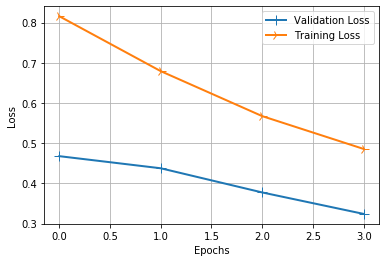

In [54]:
# Plot loss curves
# TODO: Currently there are clear signs of overfitting (with 25 epochs). Probably need more training data
# and maybe an additional dropout layer(s).
epochs_array = np.arange(epochs)
loss_values = history.history['loss']
val_loss_values = history.history['val_loss']
line1 = plt.plot(epochs_array, val_loss_values, label='Validation Loss')
line2 = plt.plot(epochs_array, loss_values, label='Training Loss')
plt.setp(line1, linewidth = 2.0, marker = '+', markersize = 10.0)
plt.setp(line2, linewidth = 2.0, marker = '4', markersize = 10.0)
plt.xlabel('Epochs') 
plt.ylabel('Loss')
plt.grid(True)
plt.legend()
plt.show()

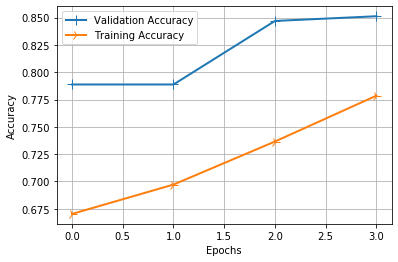

In [55]:
# Plot accuracy curves
acc_values = history.history['accuracy']
val_acc_values = history.history['val_accuracy']
line1 = plt.plot(epochs_array, val_acc_values, label='Validation Accuracy')
line2 = plt.plot(epochs_array, acc_values, label='Training Accuracy')
plt.setp(line1, linewidth = 2.0, marker = '+', markersize = 10.0)
plt.setp(line2, linewidth = 2.0, marker = '4', markersize = 10.0)
plt.xlabel('Epochs') 
plt.ylabel('Accuracy')
plt.grid(True)
plt.legend()
plt.show()

In [56]:
y_true = validation_generator.classes
y_pred = model.predict_generator(validation_generator).flatten()
class_idx_dict = validation_generator.class_indices
print('Class index for \'no_train\' is {}.'.format(class_idx_dict['no_train']))
print('Class index for \'train\' is {}.'.format(class_idx_dict['train']))

Class index for 'no_train' is 0.
Class index for 'train' is 1.


In [61]:
# TODO: eventually don't use path, use preloaded image
LAYER_NAME = 'conv2d_16'
def create_grad_cam_heatmap(img_path):
    img = tf.keras.preprocessing.image.load_img(img_path, target_size=(scaled_height, scaled_width))
    img = tf.keras.preprocessing.image.img_to_array(img)
    grad_model = tf.keras.models.Model([model.inputs], [model.get_layer(LAYER_NAME).output, model.output])
    grad_model.layers[-1].activation = None
    
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(np.array([img]))
        score = predictions[:, 0]

    output = conv_outputs[0]
    grads = tape.gradient(score, conv_outputs)[0]

    gate_f = tf.cast(output > 0, 'float32')
    gate_r = tf.cast(grads > 0, 'float32')
    guided_grads = tf.cast(output > 0, 'float32') * tf.cast(grads > 0, 'float32') * grads

    weights = tf.reduce_mean(guided_grads, axis=(0, 1))

    cam = np.ones(output.shape[0: 2], dtype = np.float32)

    for i, w in enumerate(weights):
        cam += w * output[:, :, i]

    cam = cv2.resize(cam.numpy(), (scaled_width, scaled_height))
    cam = np.maximum(cam, 0)
    heatmap = (cam - cam.min()) / (cam.max() - cam.min())

    cam = cv2.applyColorMap(np.uint8(255*heatmap), cv2.COLORMAP_JET)

    output_image_bgr = cv2.addWeighted(cv2.cvtColor(img.astype('uint8'), cv2.COLOR_RGB2BGR), 0.5, cam, 1, 0)
    output_image_rgb = output_image_bgr[:,:,::-1]
    
    return output_image_rgb

Model said no_train/coming000539.jpg contained a train (0.5924896597862244), but it didn't:


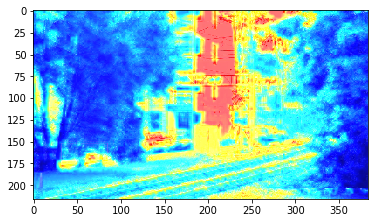

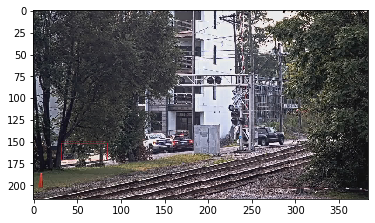

Model said no_train/coming000540.jpg contained a train (0.5995038747787476), but it didn't:


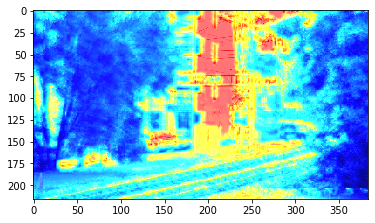

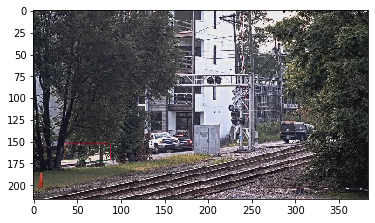

Model said no_train/coming000541.jpg contained a train (0.5956120491027832), but it didn't:


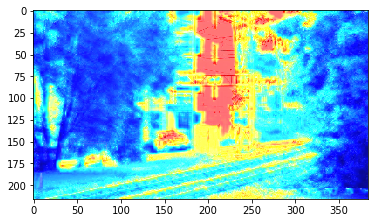

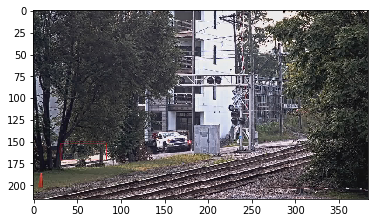

Model said no_train/coming000542.jpg contained a train (0.6089684963226318), but it didn't:


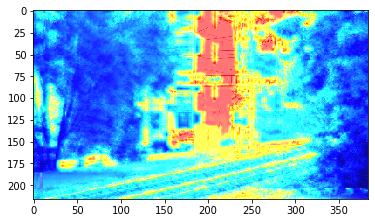

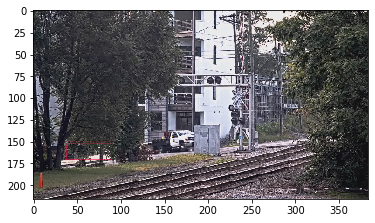

Model said no_train/coming000543.jpg contained a train (0.5952814817428589), but it didn't:


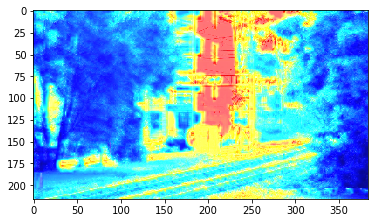

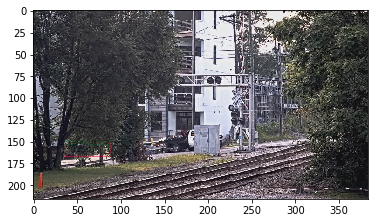

Model said no_train/coming000544.jpg contained a train (0.5898407697677612), but it didn't:


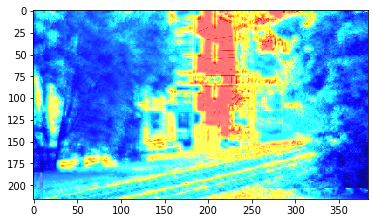

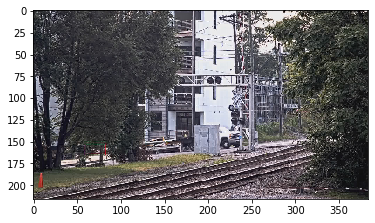

Model said no_train/coming000545.jpg contained a train (0.5830150246620178), but it didn't:


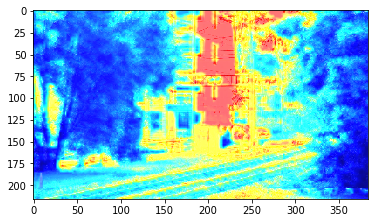

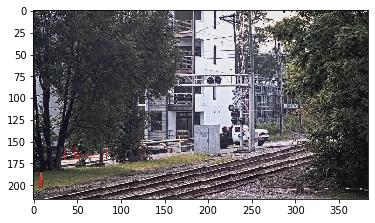

Model said no_train/coming000546.jpg contained a train (0.5838679075241089), but it didn't:


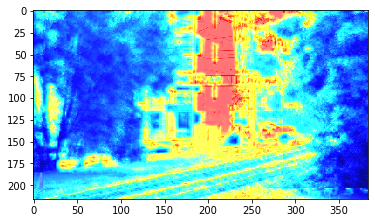

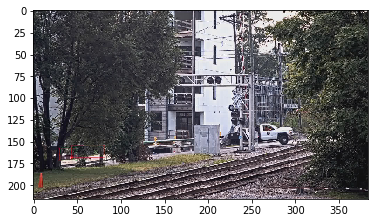

Model said no_train/coming000547.jpg contained a train (0.589974045753479), but it didn't:


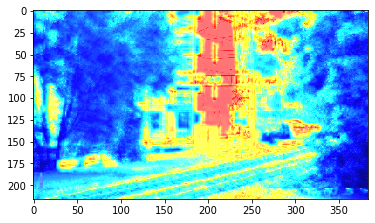

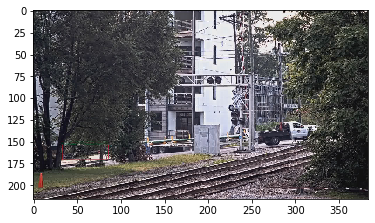

Model said no_train/coming000548.jpg contained a train (0.5814608931541443), but it didn't:


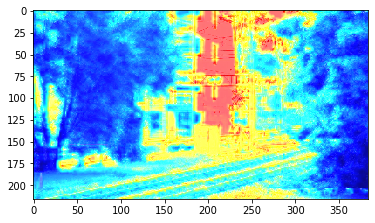

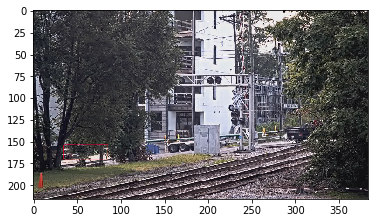

Model said no_train/coming000549.jpg contained a train (0.5834255218505859), but it didn't:


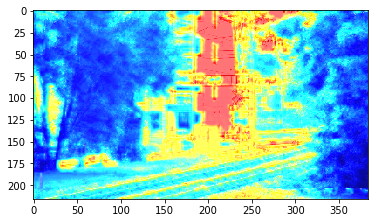

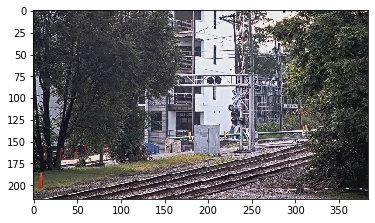

Model said no_train/coming000550.jpg contained a train (0.5888566374778748), but it didn't:


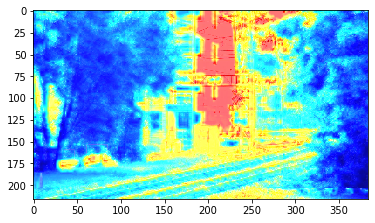

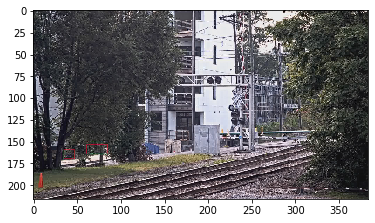

Model said no_train/coming000551.jpg contained a train (0.5837465524673462), but it didn't:


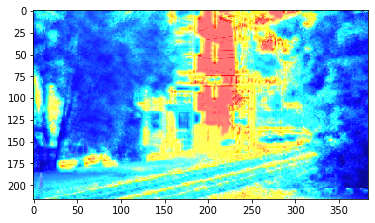

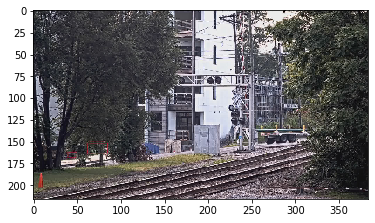

Model said no_train/coming000552.jpg contained a train (0.5800517797470093), but it didn't:


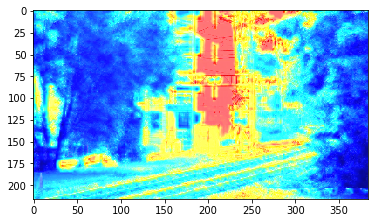

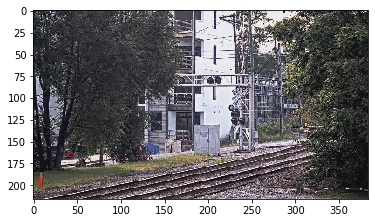

Model said no_train/coming000553.jpg contained a train (0.581635594367981), but it didn't:


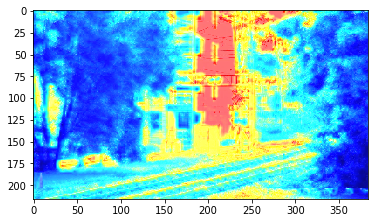

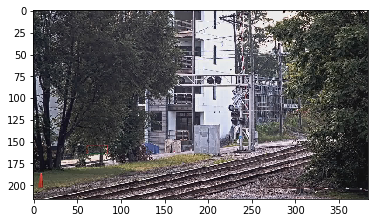

Model said no_train/coming000554.jpg contained a train (0.5844426155090332), but it didn't:


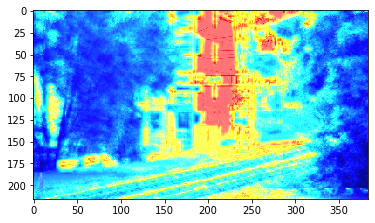

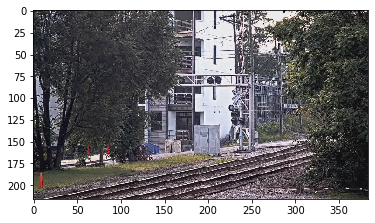

Model said no_train/coming000555.jpg contained a train (0.5856826305389404), but it didn't:


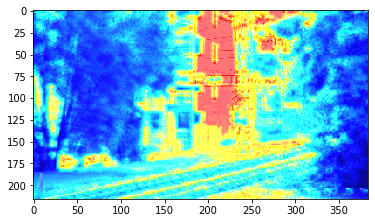

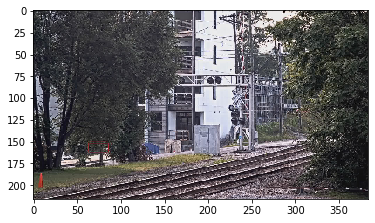

Model said no_train/coming000556.jpg contained a train (0.5826109051704407), but it didn't:


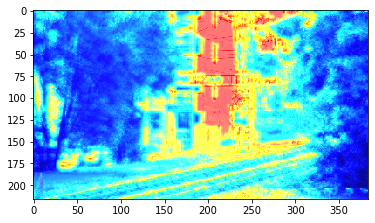

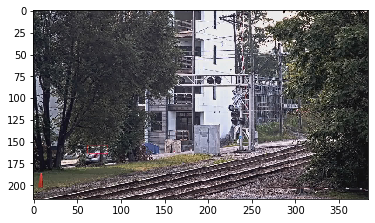

Model said no_train/coming000557.jpg contained a train (0.5942571759223938), but it didn't:


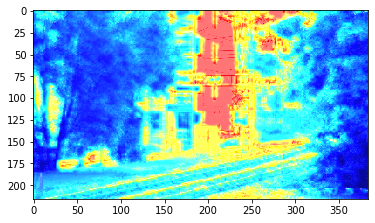

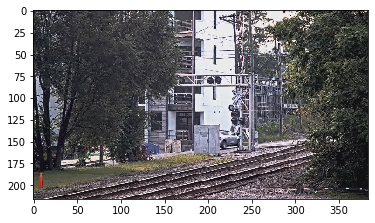

Model said no_train/coming000558.jpg contained a train (0.5946134328842163), but it didn't:


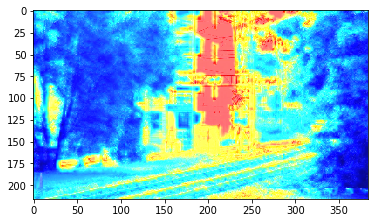

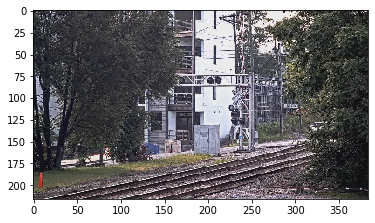

Model said no_train/coming000559.jpg contained a train (0.5956021547317505), but it didn't:


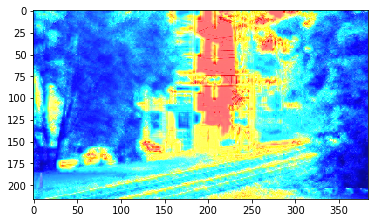

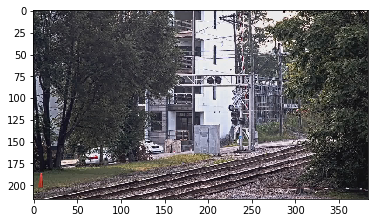

Model said no_train/coming000560.jpg contained a train (0.5861971378326416), but it didn't:


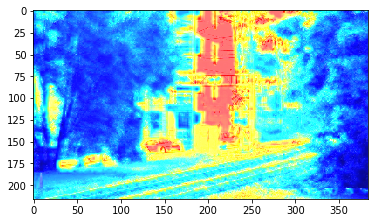

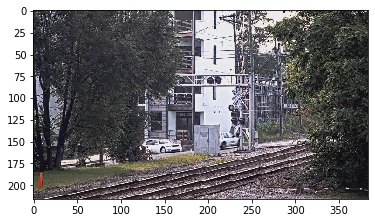

Model said no_train/coming000561.jpg contained a train (0.5879998207092285), but it didn't:


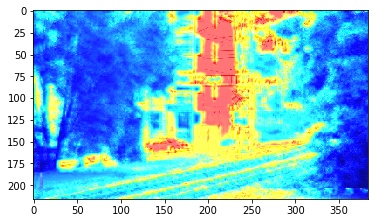

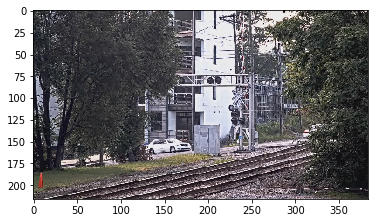

Model said no_train/coming000562.jpg contained a train (0.5891494154930115), but it didn't:


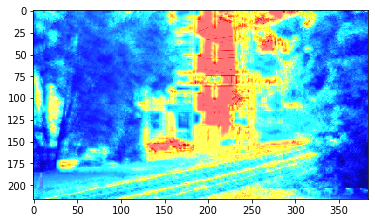

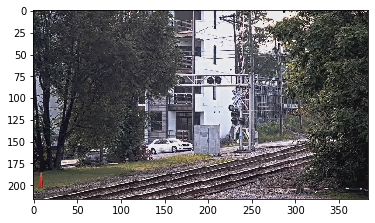

Model said no_train/variety000279.jpg contained a train (0.8372677564620972), but it didn't:


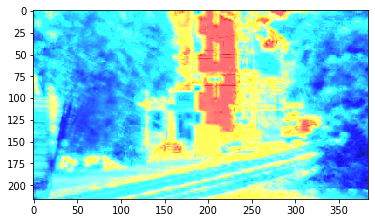

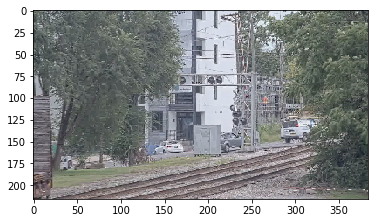

Model said no_train/variety000280.jpg contained a train (0.8297426700592041), but it didn't:


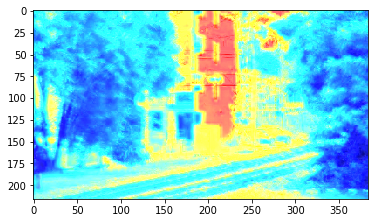

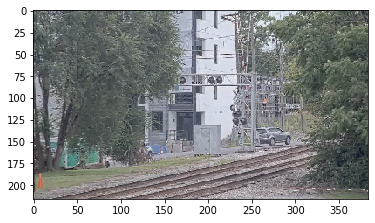

Model said no_train/variety000281.jpg contained a train (0.8284505605697632), but it didn't:


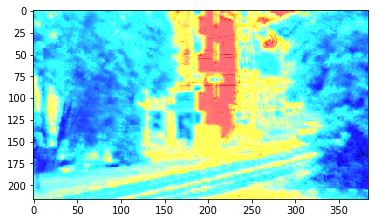

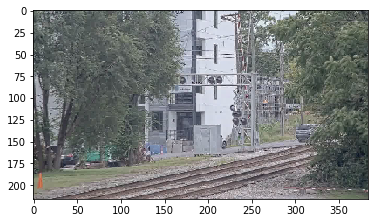

Model said no_train/variety000282.jpg contained a train (0.8251956701278687), but it didn't:


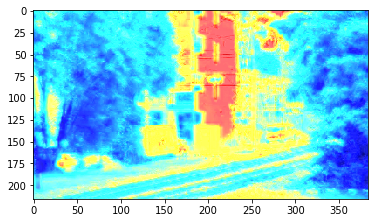

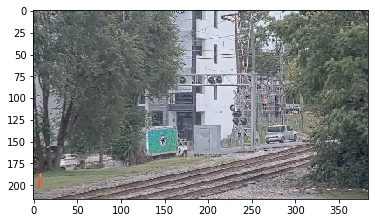

Model said no_train/variety000283.jpg contained a train (0.8270196914672852), but it didn't:


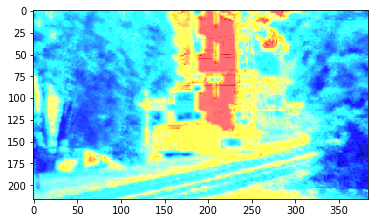

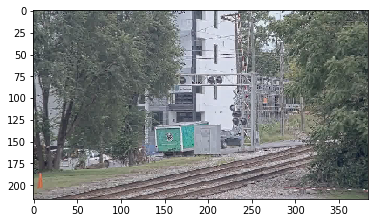

Model said no_train/variety000284.jpg contained a train (0.8285301923751831), but it didn't:


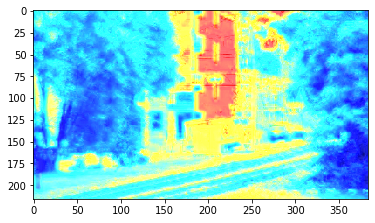

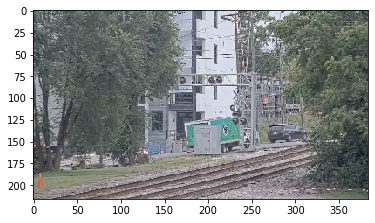

Model said no_train/variety000285.jpg contained a train (0.8246874809265137), but it didn't:


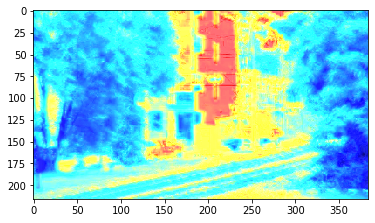

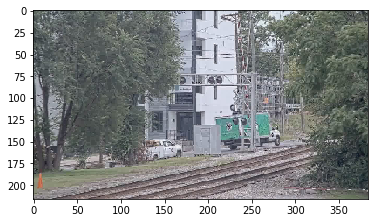

Model said no_train/variety000286.jpg contained a train (0.827792763710022), but it didn't:


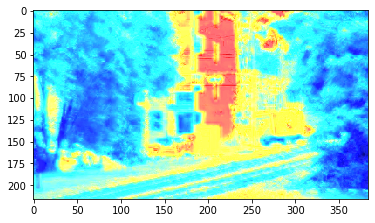

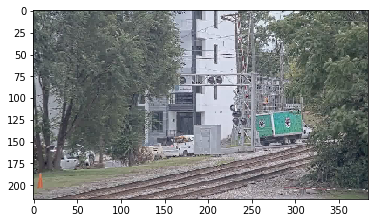

Model said no_train/variety000287.jpg contained a train (0.8298007845878601), but it didn't:


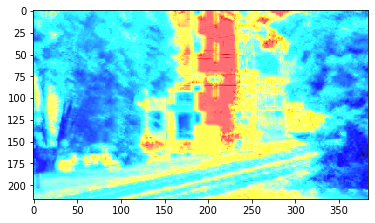

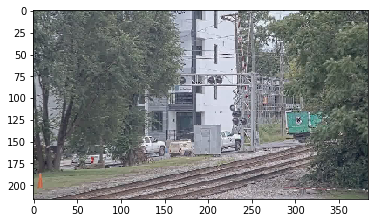

Model said no_train/variety000288.jpg contained a train (0.82645583152771), but it didn't:


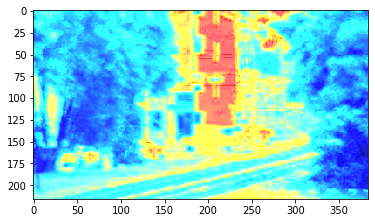

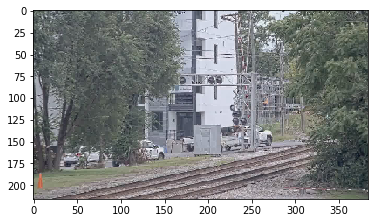

Model said no_train/variety000289.jpg contained a train (0.8282235860824585), but it didn't:


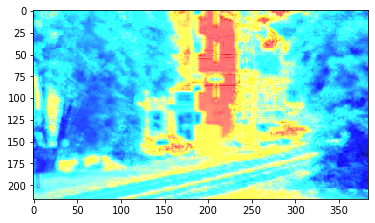

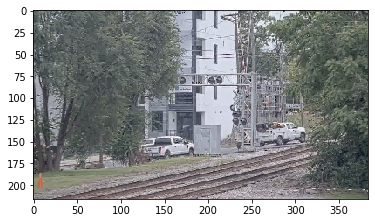

Model said no_train/variety000290.jpg contained a train (0.8266069889068604), but it didn't:


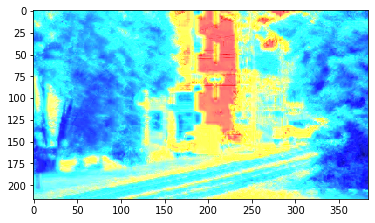

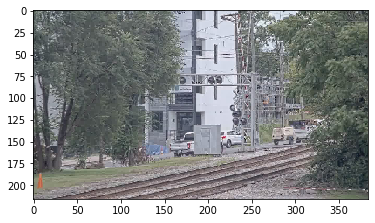

Model said no_train/variety000291.jpg contained a train (0.8286240100860596), but it didn't:


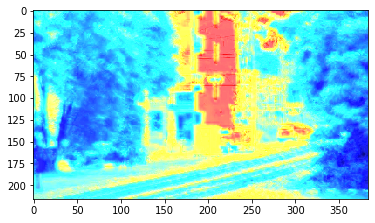

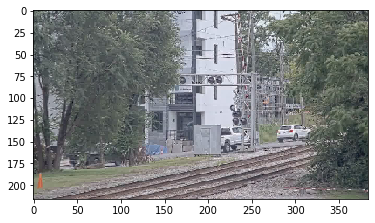

Model said no_train/variety000292.jpg contained a train (0.8304409384727478), but it didn't:


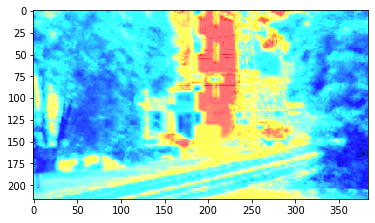

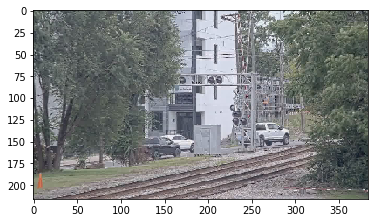

Model said no_train/variety000293.jpg contained a train (0.8259711861610413), but it didn't:


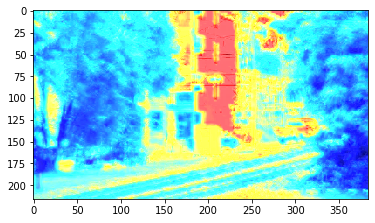

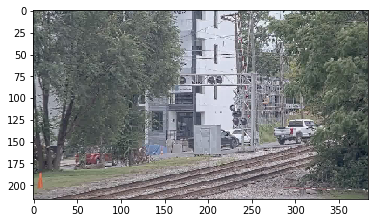

Model said no_train/variety000294.jpg contained a train (0.8308793306350708), but it didn't:


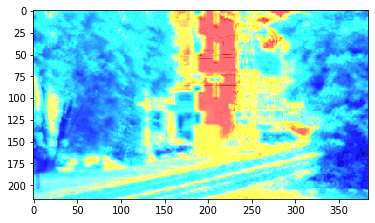

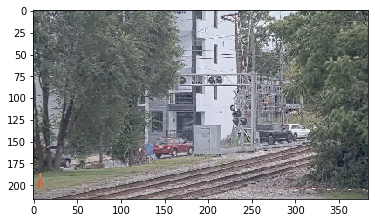

Model said no_train/variety000295.jpg contained a train (0.8289769291877747), but it didn't:


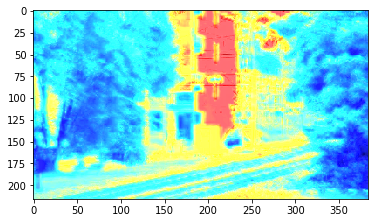

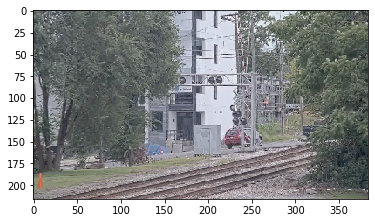

Model said no_train/variety000296.jpg contained a train (0.8285244703292847), but it didn't:


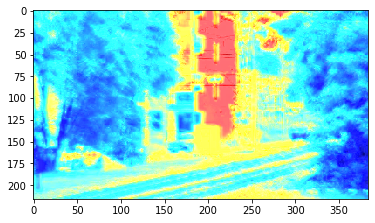

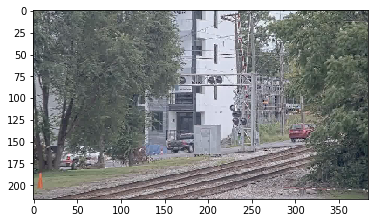

Model said no_train/variety000297.jpg contained a train (0.8255709409713745), but it didn't:


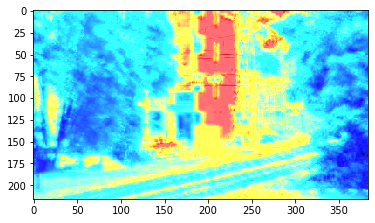

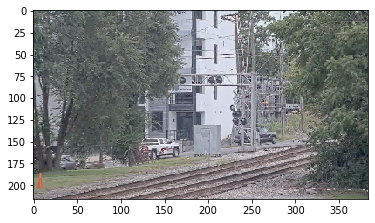

Model said no_train/variety000298.jpg contained a train (0.8255000710487366), but it didn't:


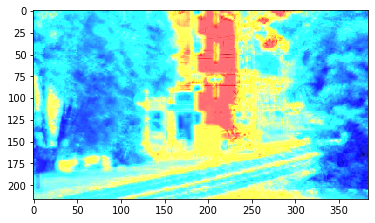

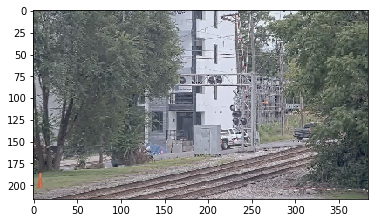

Model said no_train/variety000299.jpg contained a train (0.8272619247436523), but it didn't:


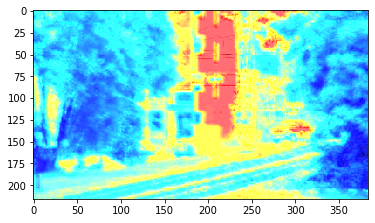

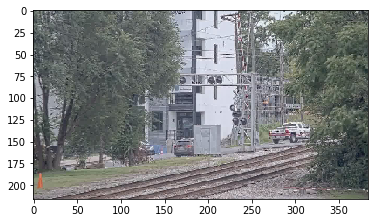

Model said no_train/variety000300.jpg contained a train (0.8271650075912476), but it didn't:


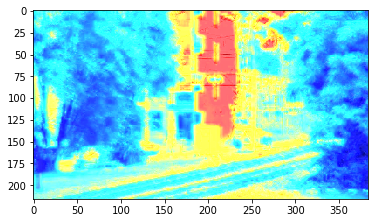

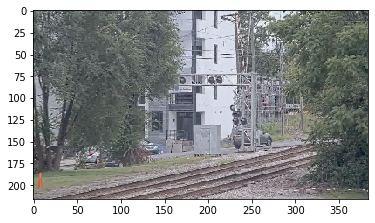

Model said no_train/variety000301.jpg contained a train (0.8276411890983582), but it didn't:


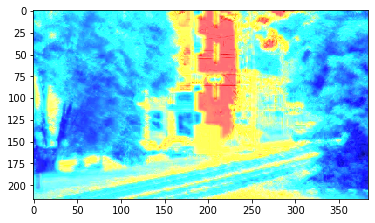

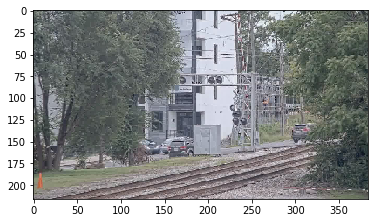

Model said no_train/variety000302.jpg contained a train (0.8275399804115295), but it didn't:


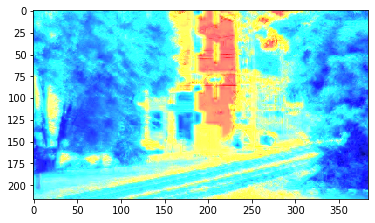

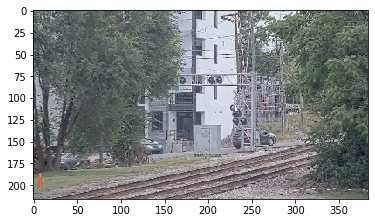

Model said no_train/variety000303.jpg contained a train (0.8268074989318848), but it didn't:


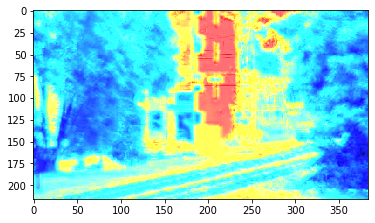

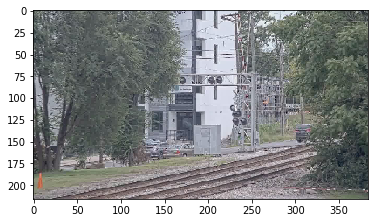

Model said no_train/variety000304.jpg contained a train (0.8278036117553711), but it didn't:


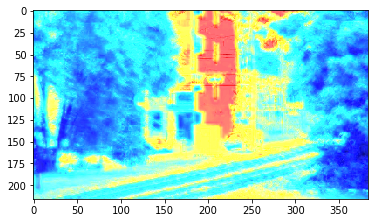

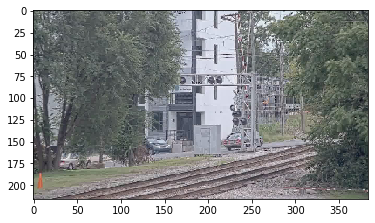

Model said no_train/variety000305.jpg contained a train (0.8258132934570312), but it didn't:


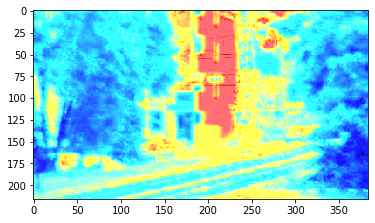

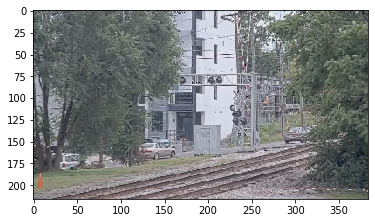

Model said no_train/variety000306.jpg contained a train (0.826282262802124), but it didn't:


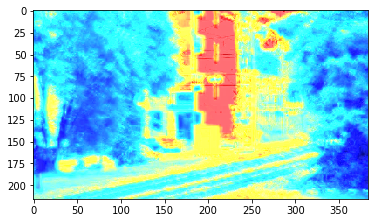

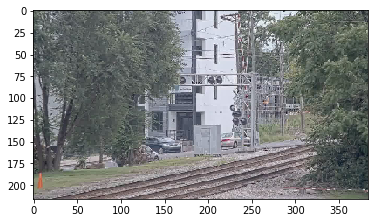

Model said no_train/variety000307.jpg contained a train (0.8274261951446533), but it didn't:


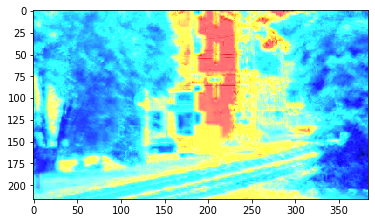

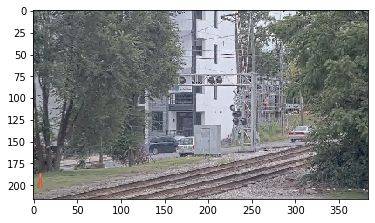

Model said no_train/variety000308.jpg contained a train (0.8244739770889282), but it didn't:


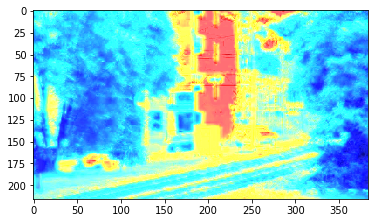

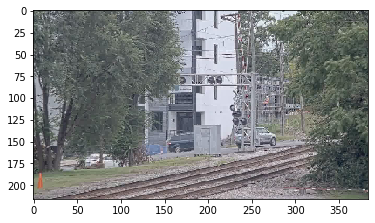

Model said no_train/variety000309.jpg contained a train (0.8285986185073853), but it didn't:


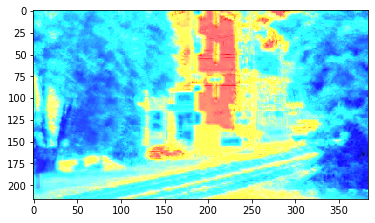

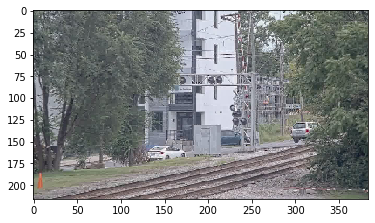

Model said no_train/variety000310.jpg contained a train (0.8265470266342163), but it didn't:


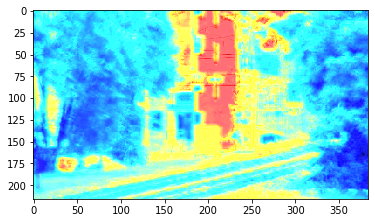

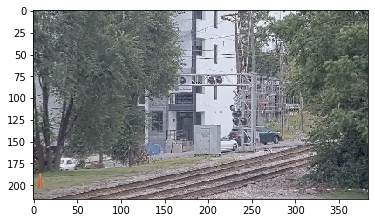

Model said no_train/variety000311.jpg contained a train (0.8244185447692871), but it didn't:


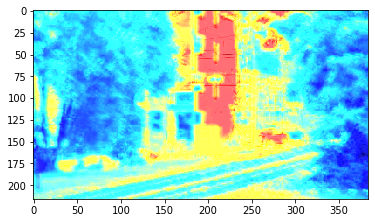

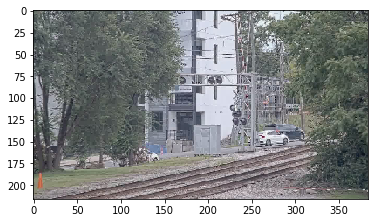

Model said no_train/variety000312.jpg contained a train (0.8259780406951904), but it didn't:


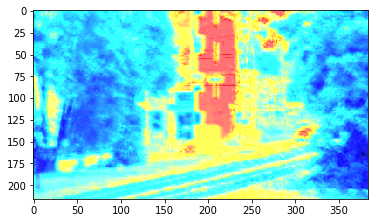

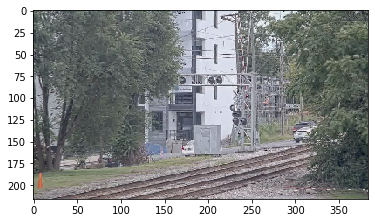

Model said no_train/variety000313.jpg contained a train (0.826195240020752), but it didn't:


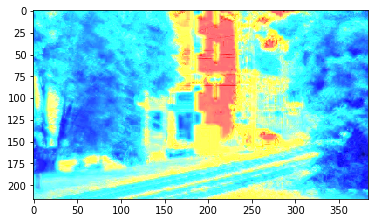

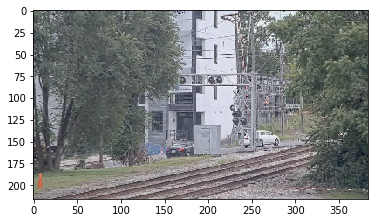

Model said no_train/variety000314.jpg contained a train (0.8260819911956787), but it didn't:


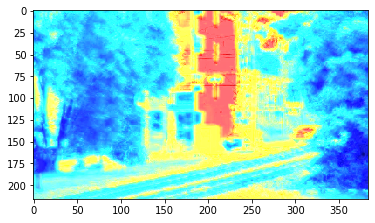

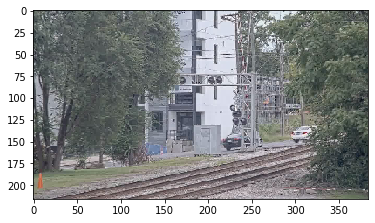

Model said no_train/variety000315.jpg contained a train (0.826422393321991), but it didn't:


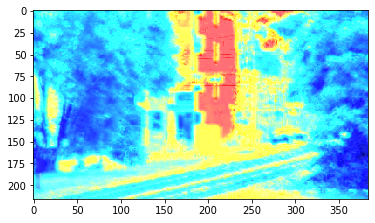

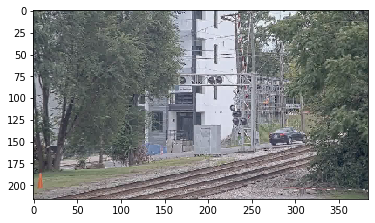

Model said no_train/variety000316.jpg contained a train (0.8258681893348694), but it didn't:


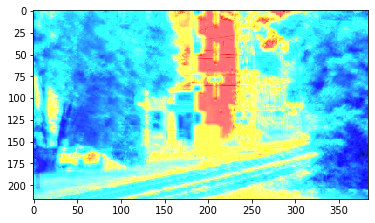

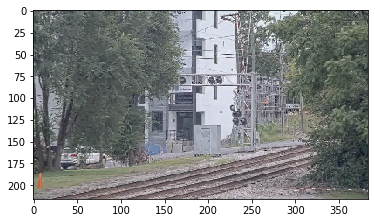

Model said no_train/variety000317.jpg contained a train (0.8255475759506226), but it didn't:


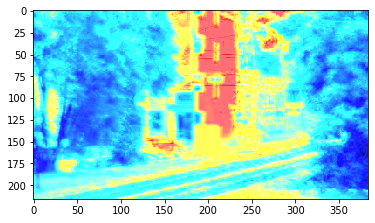

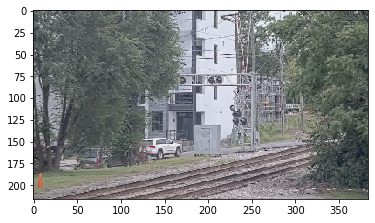

Model said no_train/variety000318.jpg contained a train (0.8260818719863892), but it didn't:


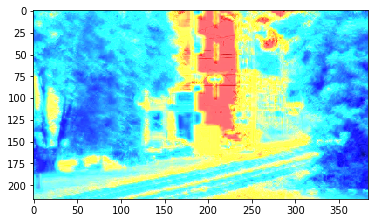

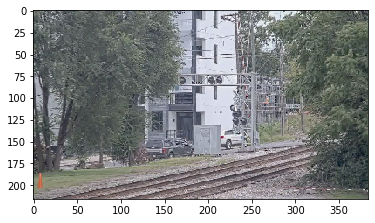

Model said no_train/variety000319.jpg contained a train (0.8270806074142456), but it didn't:


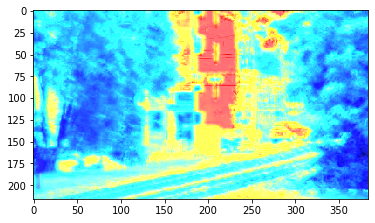

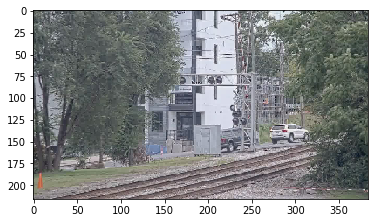

Model said no_train/variety000320.jpg contained a train (0.8249413371086121), but it didn't:


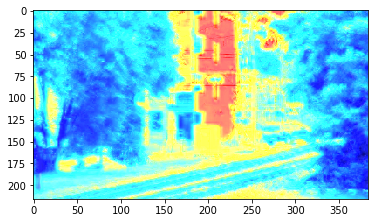

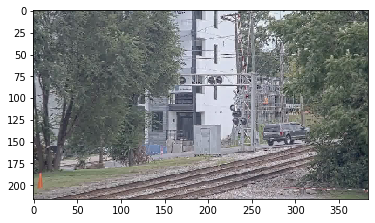

Model said no_train/variety000321.jpg contained a train (0.826348602771759), but it didn't:


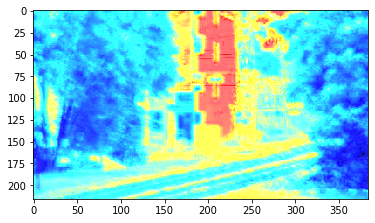

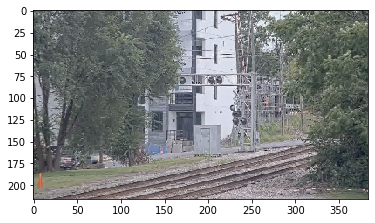

Model said no_train/variety000322.jpg contained a train (0.8247990608215332), but it didn't:


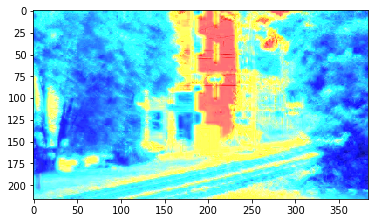

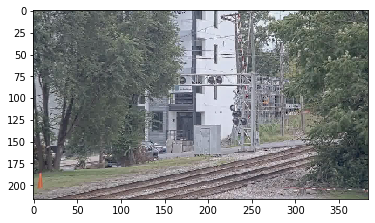

Model said no_train/variety000323.jpg contained a train (0.8272367715835571), but it didn't:


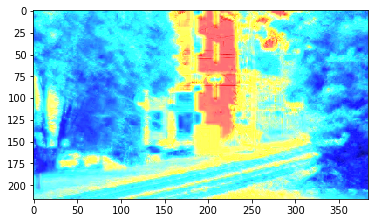

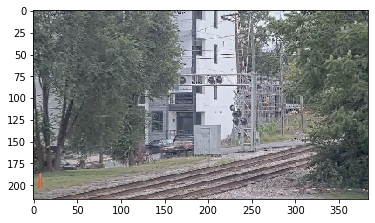

Misclassified 69 images.


In [62]:
# Round to nearest class label (1 "train" or 0 "no_train")
pred_class_idxs = np.around(y_pred)
filenames = validation_generator.filenames
miss_count = 0
for i in range(num_validation_samples):
    if int(pred_class_idxs[i]) != y_true[i]:
        miss_count += 1
        if y_true[i] == class_idx_dict['no_train']:
            print('Model said {} contained a train ({}), but it didn\'t:'.format(filenames[i], y_pred[i]))
        else:
            print('Model said {} did not contain a train ({}), but it did:'.format(filenames[i], y_pred[i]))
        batch_number = i // batch_size
        img_number = i % batch_size
        img = validation_generator[batch_number][0][img_number]
        img_heatmap = create_grad_cam_heatmap('data/validation/' + filenames[i])
        plt.imshow(img_heatmap)
        plt.show()
        plt.imshow(img)
        plt.show()

print('Misclassified {} images.'.format(miss_count))


In [45]:
cm = confusion_matrix(y_true, pred_class_idxs)
print('Confusion Matrix:')
print(cm)
true_negatives = cm[0][0]
false_negatives = cm[1][0]
true_positives = cm[1][1]
false_positives = cm[0][1]
print('True negatives: {}'.format(true_negatives))
print('False negatives: {}'.format(false_negatives))
print('True positives: {}'.format(true_positives))
print('False positives: {}'.format(false_positives))

Confusion Matrix:
[[ 53  45]
 [  0 378]]
True negatives: 53
False negatives: 0
True positives: 378
False positives: 45
